<a href="https://colab.research.google.com/github/lailatulbadriyah24/2141720036-PCVK-2023/blob/main/Week09.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Kelompok 6**

Nama: Lailatul Badriyah

Kelas: TI-3H

NIM: 2141720036

Absen: 14


---



# **Praktikum**

### **1. Menghubungkan Google Colab dengan Google Drive**

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


### **2. Mengimport library yang akan digunakan**

In [3]:
import cv2
import numpy as np
from matplotlib import pyplot as plt

### **3. Membuat fungsi dilasi serta tampilkan hasil dilasi pada citra dengan Structuring Element Dilasi (SED) berbentuk cross 3 x 3 tanpa menggunakan library morphology dari openCV**

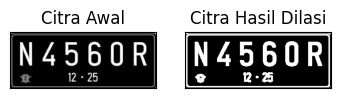

In [33]:
# Fungsi dilasi tanpa library morphology
def dilasi_citra(F, w):
    # Ukuran citra
    p, q = F.shape

    imgDilasi = np.zeros((p, q), dtype=np.uint8)

    # Generate Structuring Element Dilasi (SED)
    SED = np.ones((w, w), dtype=np.uint8)
    constant1 = (w - 1) // 2

    # Proses Dilasi
    for i in range(constant1, p - constant1):
        for j in range(constant1, q - constant1):
            temp = F[i - constant1:i + constant1 + 1, j - constant1:j + constant1 + 1]
            product = temp * SED
            imgDilasi[i, j] = np.max(product)
    return imgDilasi

dilasi_img = cv2.imread('/content/drive/MyDrive/PCVK/week09/plat nomer.jpg', 0)

# Pastikan bahwa citra telah terbaca dengan benar
if dilasi_img is not None:
    ret, thresh = cv2.threshold(dilasi_img, 125, 200, cv2.THRESH_BINARY)
    w = 3
    result_dilasi = dilasi_citra(thresh, w)

    plt.subplot(131), plt.imshow(dilasi_img, cmap='gray')
    plt.title('Citra Awal'), plt.xticks([]), plt.yticks([])
    plt.subplot(132), plt.imshow(result_dilasi, cmap='gray')
    plt.title('Citra Hasil Dilasi'), plt.xticks([]), plt.yticks([])
    plt.show()
else:
    print("Gagal membaca citra")

### **4. Mengimplementasi operasi dilasi Structuring Element Dilasi (SED) berbentuk cross 3 x 3 dengan menggunakan library morphology dari openCV**

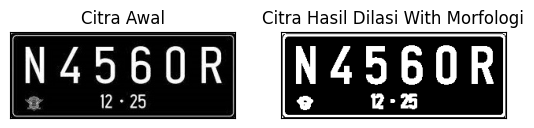

In [34]:
# Menggunakan threshold pada citra hasil dilasi
ret, thresh = cv2.threshold(dilasi_img, 127, 225, cv2.THRESH_BINARY)

# Membuat kernel untuk operasi dilasi
kernel = np.ones((3, 3), np.uint8)  # Menggunakan np.uint8

# Melakukan operasi dilasi menggunakan OpenCV
dilasi = cv2.dilate(thresh, kernel, iterations=1)

# Menampilkan citra asli (dilasi_img) dalam format warna
plt.subplot(121), plt.imshow(cv2.cvtColor(dilasi_img, cv2.COLOR_BGR2RGB), cmap='gray')
plt.title('Citra Awal')
plt.xticks([]), plt.yticks([])

# Menampilkan citra hasil dilasi
plt.subplot(122), plt.imshow(dilasi, cmap='gray')
plt.title('Citra Hasil Dilasi With Morfologi')
plt.xticks([]), plt.yticks([])
plt.show()

### **5. Membuat fungsi erosi serta tampilkan hasil erosi pada citra dengan Structuring Element Erosi (SE) berbentuk square 5 x 5 tanpa menggunakan library morphology dari openCV**

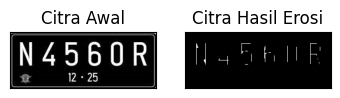

In [25]:
# Fungsi erosi tanpa library morphology
def erosi_citra(F, k):
    # Ukuran citra
    m, n = F.shape

    # Membuat Structuring Element Erosi (SE) berbentuk square
    SE = np.ones((k, k), dtype=np.uint8)
    constant = (k - 1) // 2

    imgErosi = np.zeros((m, n), dtype=np.uint8)

    # Proses Erosi
    for i in range(constant, m - constant):
        for j in range(constant, n - constant):
            temp = F[i - constant:i + constant + 1, j - constant:j + constant + 1]
            product = temp * SE
            imgErosi[i, j] = np.min(product)

    return imgErosi

erosi_img = cv2.imread('/content/drive/MyDrive/PCVK/week09/plat nomer.jpg', 0)

# Periksa apakah citra berhasil dimuat
if erosi_img is not None:
    ret1, thresh1 = cv2.threshold(erosi_img, 175, 225, cv2.THRESH_BINARY)
    k = 5
    result_erosi = erosi_citra(thresh1, k)

    plt.subplot(131), plt.imshow(erosi_img, cmap='gray')
    plt.title('Citra Awal'), plt.xticks([]), plt.yticks([])
    plt.subplot(132), plt.imshow(result_erosi, cmap='gray')
    plt.title('Citra Hasil Erosi'), plt.xticks([]), plt.yticks([])
    plt.show()
else:
    print("Gagal membaca citra")

### **6. Mengimplementasi operasi dilasi Structuring Element Erosi (SE) berbentuk square 5 x 5 dengan menggunakan library morphology dari openCV**

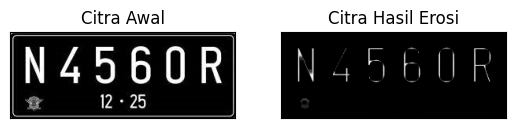

In [28]:
kernel = np.ones((5,5), np.uint8)
eroded_img = cv2.erode(erosi_img, kernel, iterations = 1)

plt.subplot(121), plt.imshow(erosi_img, cmap='gray'), plt.title('Citra Awal')
plt.xticks([]), plt.yticks([])
plt.subplot(122), plt.imshow(eroded_img, cmap='gray'), plt.title('Citra Hasil Erosi')
plt.xticks([]), plt.yticks([])
plt.show()

### **7. Mengimplementasikan operasi opening dengan Structuring Element berbentuk square 3 x 3 tanpa dan dengan menggunakan library morphology dari openCV**

**Tanpa menggunakan library morphology**

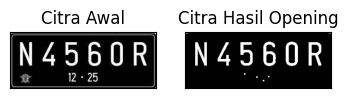

In [38]:
opening_img = cv2.imread('/content/drive/MyDrive/PCVK/week09/plat nomer.jpg', 0)
reto, thresho = cv2.threshold(opening_img, 127, 225, cv2.THRESH_BINARY)
k = 3  # SE berbentuk square 3x3

# Melakukan operasi opening
result_opening = dilasi_citra(erosi_citra(thresho, k), k)

plt.subplot(131), plt.imshow(opening_img, cmap='gray')
plt.title('Citra Awal'), plt.xticks([]), plt.yticks([])
plt.subplot(132), plt.imshow(result_opening, cmap='gray')
plt.title('Citra Hasil Opening'), plt.xticks([]), plt.yticks([])
plt.show()

**Menggunakan library morphology**

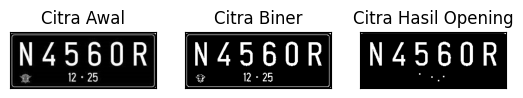

In [51]:
# Thresholding
ret, thresh = cv2.threshold(opening_img, 127, 255, cv2.THRESH_BINARY)

# Buat kernel untuk operasi opening (SE square 3x3)
kernel = np.ones((3, 3), np.uint8)

# Melakukan operasi opening
opened_image = cv2.morphologyEx(thresh, cv2.MORPH_OPEN, kernel)

# Menampilkan citra asli, citra biner, dan citra hasil opening
plt.subplot(131), plt.imshow(opening_img, cmap='gray')
plt.title('Citra Awal'), plt.xticks([]), plt.yticks([])
plt.subplot(132), plt.imshow(thresh, cmap='gray')
plt.title('Citra Biner'), plt.xticks([]), plt.yticks([])
plt.subplot(133), plt.imshow(opened_image, cmap='gray')
plt.title('Citra Hasil Opening'), plt.xticks([]), plt.yticks([])
plt.show()

### **8. Mengimplementasi operasi closing dengan Structuring Element berbentuk  square 3 x 3 tanpa dan dengan menggunakan library morphology dari openCV**

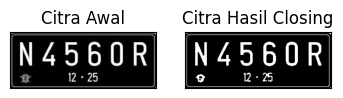

In [50]:
# Baca citra (pastikan path ke gambar adalah path yang benar)
closing_img = cv2.imread('/content/drive/MyDrive/PCVK/week09/plat nomer.jpg', 0)

if closing_img is not None:
    # Thresholding
    retc, threshc = cv2.threshold(closing_img, 127, 255, cv2.THRESH_BINARY)

    k = 3  # SE berbentuk square 3x3

    # Melakukan operasi closing (dilate + erode)
    dilated_image = cv2.dilate(threshc, np.ones((k, k), np.uint8))
    closed_image = cv2.erode(dilated_image, np.ones((k, k), np.uint8))

    # Menampilkan citra asli dan citra hasil closing
    plt.subplot(131), plt.imshow(closing_img, cmap='gray')
    plt.title('Citra Awal'), plt.xticks([]), plt.yticks([])
    plt.subplot(132), plt.imshow(closed_image, cmap='gray')
    plt.title('Citra Hasil Closing'), plt.xticks([]), plt.yticks([])
    plt.show()
else:
    print("Gagal membaca citra")

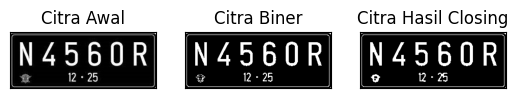

In [54]:
ret, thresh = cv2.threshold(closing_img, 127, 225, cv2.THRESH_BINARY)
kernel = np.ones((3,3),np.uint8)
result_closing = cv2.morphologyEx(thresh,cv2.MORPH_CLOSE, kernel)

plt.subplot(131),plt.imshow(closing_img,cmap = 'gray')
plt.title('Citra Awal'), plt.xticks([]), plt.yticks([])
plt.subplot(132),plt.imshow(thresh,cmap = 'gray')
plt.title('Citra Biner'), plt.xticks([]), plt.yticks([])
plt.subplot(133),plt.imshow(result_closing,cmap = 'gray')
plt.title('Citra Hasil Closing'), plt.xticks([]), plt.yticks([])
plt.show()

### **9. Mengimplementasi operasi dilasi dengan Structuring Element berbentuk  Cross 3 x 3 dan 5 x 5**

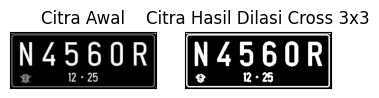

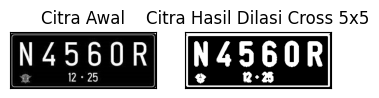

In [61]:
def main(image_path, SED, title):
    img = cv2.imread(image_path, 0)
    ret, thresh = cv2.threshold(img, 127, 255, cv2.THRESH_BINARY)
    w = SED.shape[0]
    imgD = dilasi_citra(thresh, SED)

    plt.subplot(131), plt.imshow(img, cmap='gray')
    plt.title('Citra Awal'), plt.xticks([]), plt.yticks([])
    plt.subplot(132), plt.imshow(imgD, cmap='gray')
    plt.title('Citra Hasil ' + title), plt.xticks([]), plt.yticks([])
    plt.show()

# SE Cross 3x3
SED_cross_3x3 = np.array([[0, 1, 0],
                          [1, 1, 1],
                          [0, 1, 0]], dtype=np.uint8)
main('/content/drive/MyDrive/PCVK/week09/plat nomer.jpg', SED_cross_3x3, 'Dilasi Cross 3x3')

# SE Cross 5x5
SED_cross_5x5 = np.array([[0, 0, 1, 0, 0],
                          [0, 0, 1, 0, 0],
                          [1, 1, 1, 1, 1],
                          [0, 0, 1, 0, 0],
                          [0, 0, 1, 0, 0]], dtype=np.uint8)
main('/content/drive/MyDrive/PCVK/week09/plat nomer.jpg', SED_cross_5x5, 'Dilasi Cross 5x5')

### **10.  Mengimplementasi operasi dilasi dengan Structuring Element berbentuk Circular 3 x 3 dan 5 x 5**

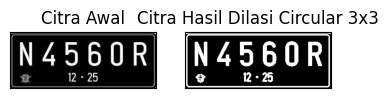

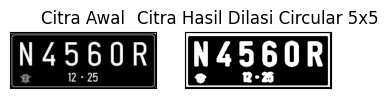

In [62]:
def main(image_path, SED, title):
    img = cv2.imread(image_path, 0)
    ret, thresh = cv2.threshold(img, 127, 255, cv2.THRESH_BINARY)
    imgD = dilasi_citra(thresh, SED)

    plt.subplot(131), plt.imshow(img, cmap='gray')
    plt.title('Citra Awal'), plt.xticks([]), plt.yticks([])
    plt.subplot(132), plt.imshow(imgD, cmap='gray')
    plt.title('Citra Hasil ' + title), plt.xticks([]), plt.yticks([])
    plt.show()

# SE Circular 3x3
SED_circular_3x3 = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (3, 3))
main('/content/drive/MyDrive/PCVK/week09/plat nomer.jpg', SED_circular_3x3, 'Dilasi Circular 3x3')

# SE Circular 5x5
SED_circular_5x5 = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (5, 5))
main('/content/drive/MyDrive/PCVK/week09/plat nomer.jpg', SED_circular_5x5, 'Dilasi Circular 5x5')

### **11. Mengimplementasi operasi erosi dengan Structuring Element berbentuk Rectangle 3 x 5 dan 5 x 7**

SE = Rectangle 3x5


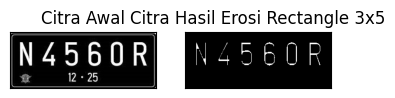

SE = Rectangle 5x7


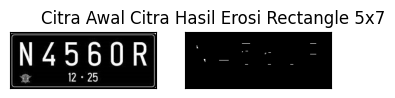

In [79]:
def main(image_path, p, l, title):
    img = cv2.imread(image_path, 0)
    ret, thresh = cv2.threshold(img, 127, 225, cv2.THRESH_BINARY)
    imgE = erosi_citra(thresh, p, l)

    plt.subplot(131), plt.imshow(img, cmap='gray')
    plt.title('Citra Awal'), plt.xticks([]), plt.yticks([])
    plt.subplot(132), plt.imshow(imgE, cmap='gray')
    plt.title('Citra Hasil ' + title), plt.xticks([]), plt.yticks([])
    plt.show()

print('SE = Rectangle 3x5')
main('/content/drive/MyDrive/PCVK/week09/plat nomer.jpg', 5, 3, 'Erosi Rectangle 3x5')

print('SE = Rectangle 5x7')
main('/content/drive/MyDrive/PCVK/week09/plat nomer.jpg', 7, 5, 'Erosi Rectangle 5x7')

### **12. Mengimplementasi operasi erosi dengan Structuring Element berbentuk Line Vertikal 3 dan 5**

SE = Line Vertikal 3


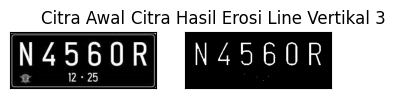

SE = Line Vertikal 5


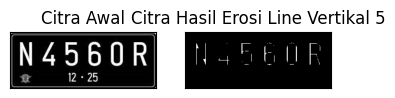

In [129]:
def main(image_path, k, title):
    img = cv2.imread(image_path, 0)
    ret, thresh = cv2.threshold(img, 127, 225, cv2.THRESH_BINARY)
    imgE = erosi_citra(thresh, k)

    plt.subplot(131), plt.imshow(img, cmap='gray')
    plt.title('Citra Awal'), plt.xticks([]), plt.yticks([])
    plt.subplot(132), plt.imshow(imgE, cmap='gray')
    plt.title('Citra Hasil ' + title), plt.xticks([]), plt.yticks([])
    plt.show()

print('SE = Line Vertikal 3')
main('/content/drive/MyDrive/PCVK/week09/plat nomer.jpg', 3, 'Erosi Line Vertikal 3')

print('SE = Line Vertikal 5')
main('/content/drive/MyDrive/PCVK/week09/plat nomer.jpg', 5, 'Erosi Line Vertikal 5')

### **13. TopHat**

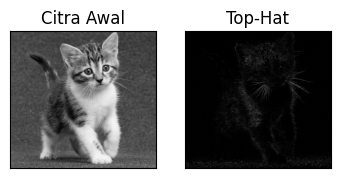

In [88]:
kitten = cv2.imread('/content/drive/MyDrive/PCVK/week09/kitten01.jpg',0)
# Define the structuring element (SE) - Square 3x3
se_square_3x3 = np.ones((3, 3), dtype=np.uint8)

# Perform top-hat operation
tophat = cv2.morphologyEx(kitten, cv2.MORPH_TOPHAT, se_square_3x3)

# Display the results
plt.subplot(131), plt.imshow(kitten, cmap='gray'), plt.title('Citra Awal')
plt.xticks([]), plt.yticks([])
plt.subplot(132), plt.imshow(tophat, cmap='gray'), plt.title('Top-Hat')
plt.xticks([]), plt.yticks([])
plt.show()

### **13. BlackHat**

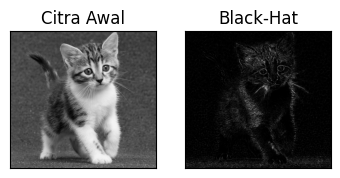

In [91]:
kitten = cv2.imread('/content/drive/MyDrive/PCVK/week09/kitten01.jpg',0)
# Define the structuring element (SE) - Square 3x3
se_square_5x5 = np.ones((5, 5), dtype=np.uint8)

# Perform black-hat operation
blackhat = cv2.morphologyEx(kitten, cv2.MORPH_BLACKHAT, se_square_5x5)

# Display the results
plt.subplot(131), plt.imshow(kitten, cmap='gray'), plt.title('Citra Awal')
plt.xticks([]), plt.yticks([])
plt.subplot(132), plt.imshow(blackhat, cmap='gray'), plt.title('Black-Hat')
plt.xticks([]), plt.yticks([])
plt.show()

### **13. Skeleton**

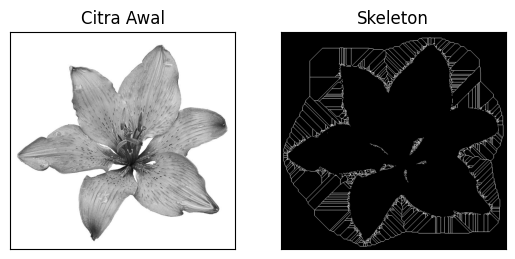

In [94]:
from skimage import filters
from skimage.morphology import skeletonize

lily = cv2.imread('/content/drive/MyDrive/PCVK/week09/lily.jpg',0)
bin = lily > filters.threshold_triangle(lily)

# true false to one
binary = bin.copy()
binary[binary == True] = 1
binary[binary == False] = 0

# skeletonize image
skeleton = skeletonize(binary)

plt.subplot(121), plt.imshow(lily, cmap = 'gray'), plt.title('Citra Awal'),
plt.xticks([]), plt.yticks([])
plt.subplot(122),plt.imshow(skeleton, cmap = 'gray'), plt.title('Skeleton'),
plt.xticks([]), plt.yticks([])
plt.show()

### **13. Skeleton Inverse**

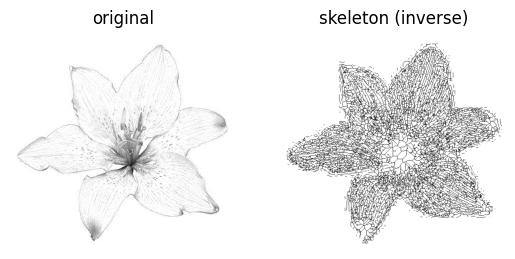

In [99]:
from skimage import io

# read image
img = io.imread('/content/drive/MyDrive/PCVK/week09/lily.jpg')[..., 0]

# Note: we want the black bits to be True, so use <
binary = img < filters.threshold_triangle(img)

# skeletonize image
skeleton = skeletonize(binary)

# print images
fig, ax = plt.subplots(1, 2)
ax[0].imshow(img, cmap='gray')
ax[0].set_title('original')
ax[0].set_axis_off()

# note the reversed colormap, gray_r
ax[1].imshow(skeleton, cmap='gray_r')
ax[1].set_title('skeleton (inverse)')
ax[1].set_axis_off()
plt.show()

# **14. Thickening**

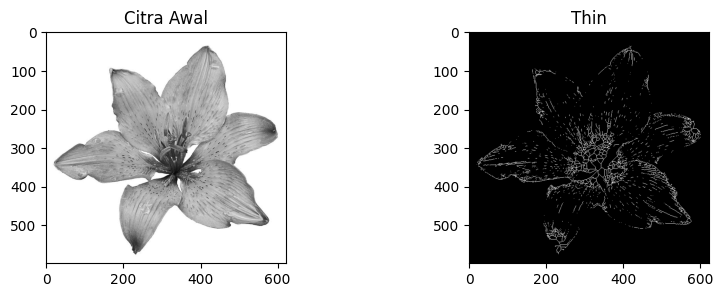

In [101]:
from skimage import io, color, morphology

image = color.rgb2gray(io.imread('/content/drive/MyDrive/PCVK/week09/lily.jpg'))  # Ganti dengan path ke citra Anda

# Binarize the grayscale image with a suitable threshold
binary_image = image < 0.5

# Perform thickening operation
thickened_image = morphology.thin(binary_image)

# Display the results
f, (ax0, ax1) = plt.subplots(1, 2, figsize=(10, 3))
ax0.imshow(lily, cmap='gray')
ax0.set_title('Citra Awal')
ax1.imshow(thickened_image, cmap='gray')
ax1.set_title('Thin')
plt.show()


## **Tugas Praktikum**

Tugas Praktikum Morfologi melibatkan implementasi dataset KTP yang terdapat dalam Modul 7. Dalam tugas ini, kita akan menggunakan semua informasi yang disediakan dalam modul Morfologi dan menerapkan sejumlah nilai tambahan dalam kode sumber. Tujuannya adalah agar citra KTP dapat terbaca dengan baik ketika teknik morfologi diterapkan pada citra tersebut.


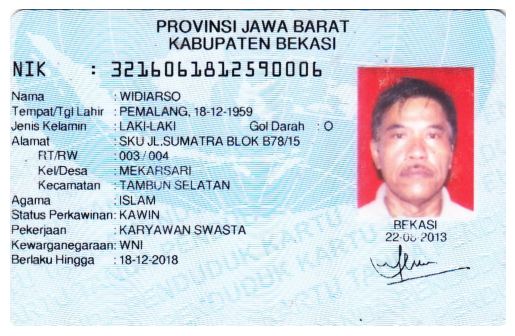

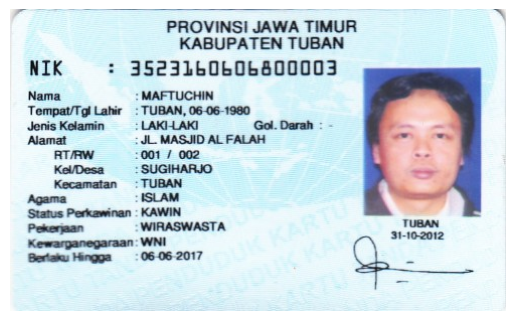

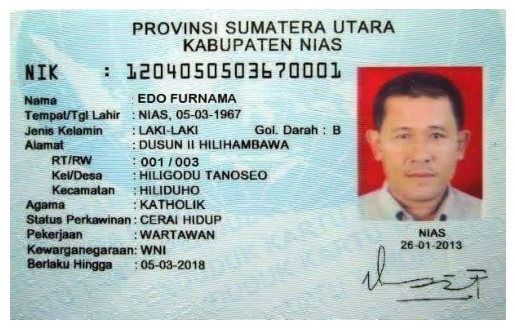

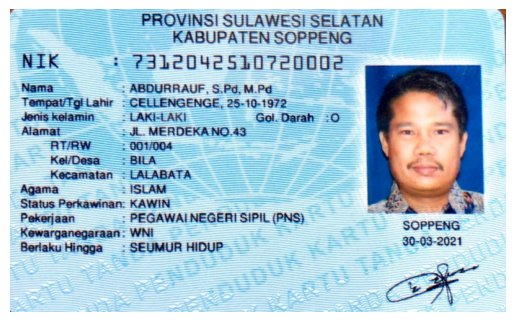

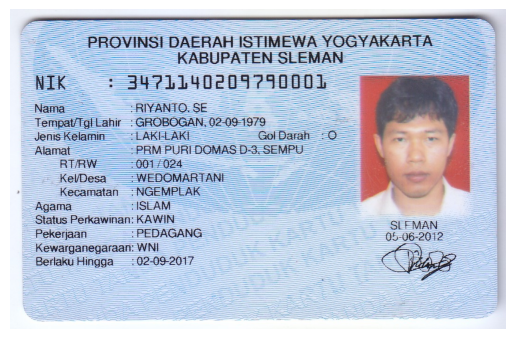

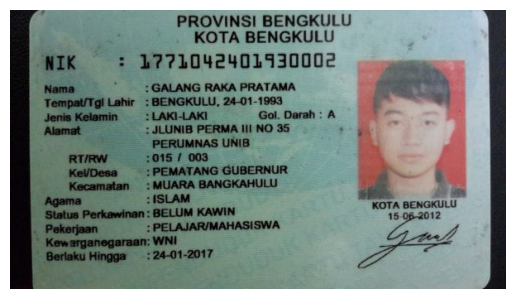

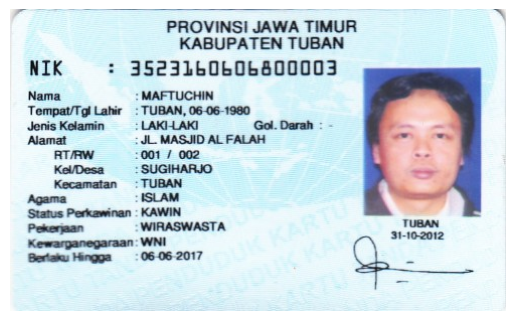

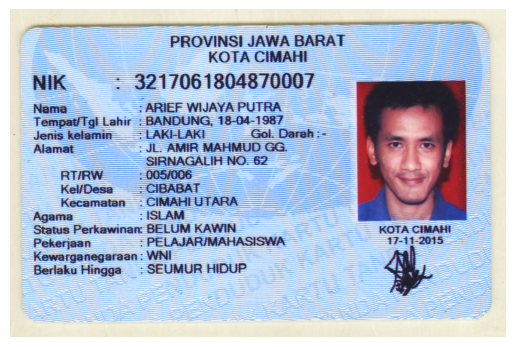

In [148]:
path = '/content/drive/MyDrive/PCVK/ktp/'

# Dapatkan daftar file citra dalam folder
ktp_files = [file for file in os.listdir(path) if file.lower().endswith(('.png', '.jpg', '.jpeg'))]
# Iterasi pada gambar-gambar KTP
for i, ktp_file in enumerate(ktp_files):
    ktp_path = os.path.join(path, ktp_file)
    ktp_image = cv2.imread(ktp_path)

     # Tampilkan gambar
    plt.figure()
    plt.axis('off')
    plt.imshow(cv2.cvtColor(ktp_image, cv2.COLOR_BGR2RGB))
    plt.show()

### **Dilasi**

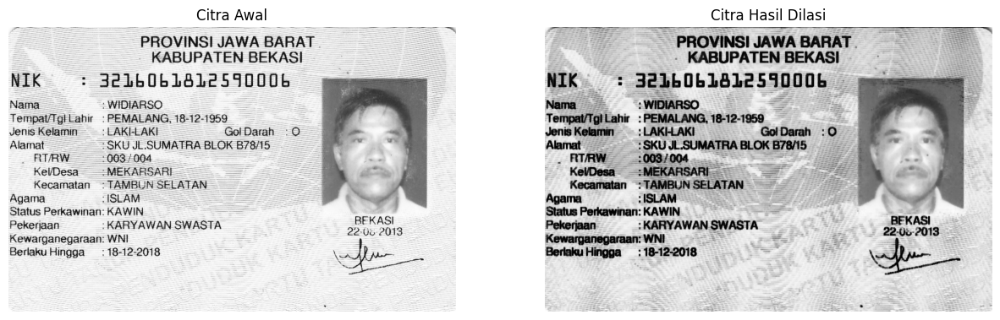

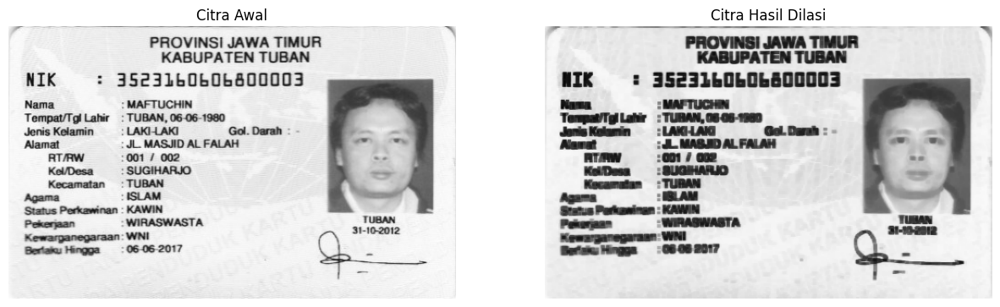

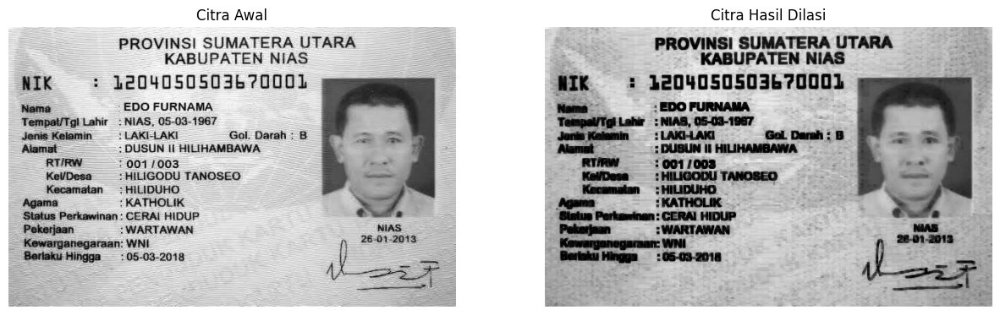

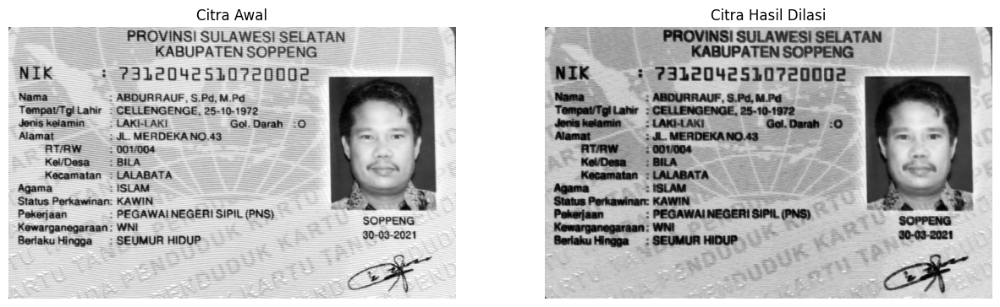

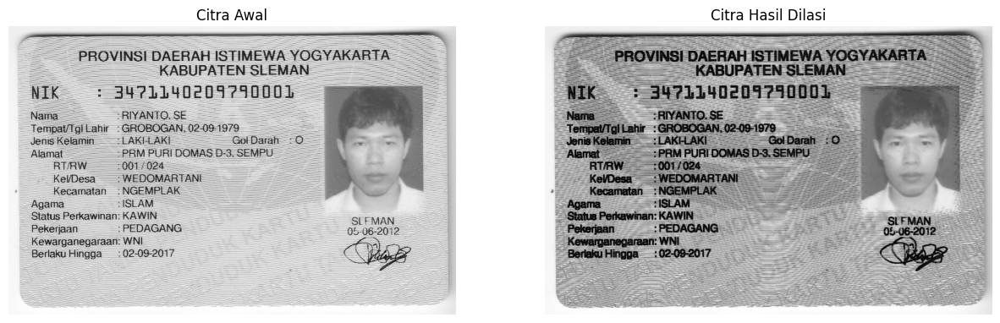

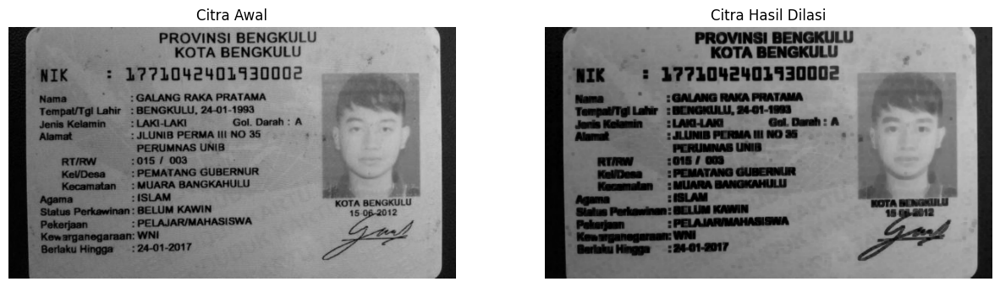

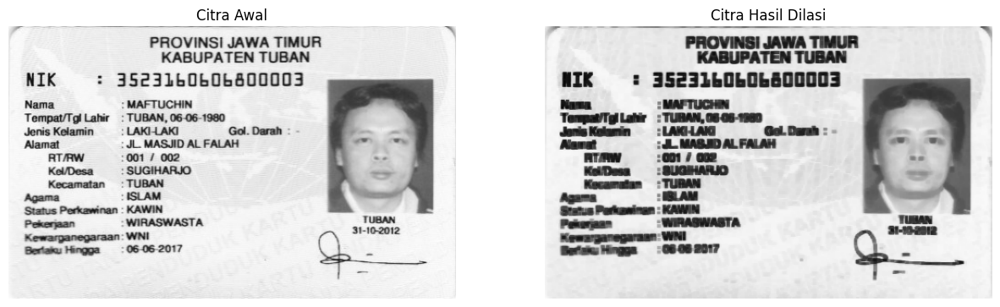

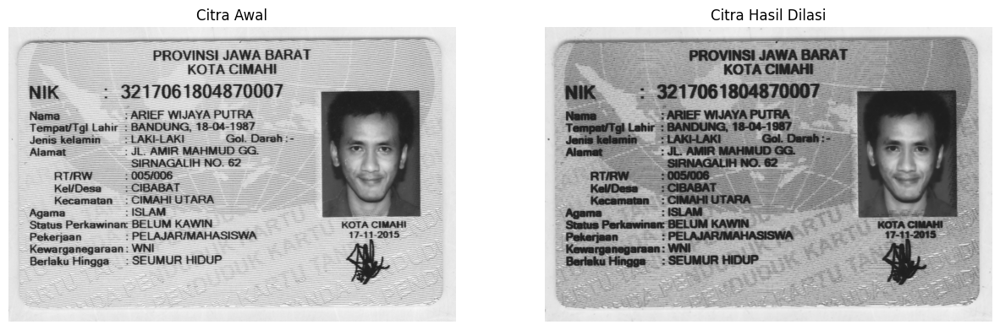

In [151]:
def inverse(image):
  return 255-image

ktp_files = [file for file in os.listdir(path) if file.lower().endswith(('.png', '.jpg', '.jpeg'))]

for i, ktp_file in enumerate(ktp_files):
    ktp_path = os.path.join(path, ktp_file)

    ktp_image = cv2.imread(ktp_path, cv2.IMREAD_GRAYSCALE)

    inverse_img = inverse(ktp_image)

    kernel = np.ones((3,3), np.uint8)

    dilation = cv2.morphologyEx(inverse_img, cv2.MORPH_DILATE, kernel)
    dilation_rgb = cv2.cvtColor(dilation, cv2.COLOR_GRAY2RGB)
    plt.figure(figsize=(15,15))
    plt.subplot(121), plt.imshow(cv2.cvtColor(ktp_image, cv2.COLOR_GRAY2RGB)), plt.title('Citra Awal')
    plt.axis('off')
    plt.subplot(122), plt.imshow(255-dilation_rgb), plt.title('Citra Hasil Dilasi')
    plt.axis('off')

### **Erosi**

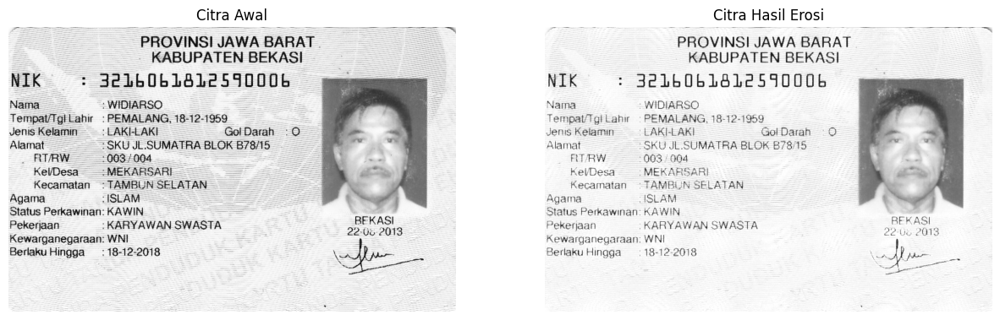

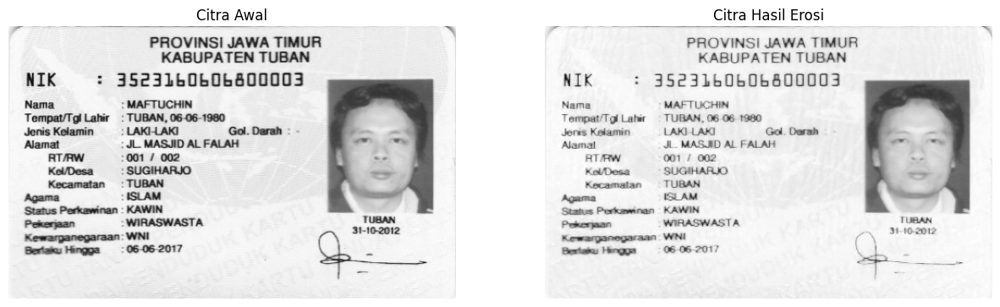

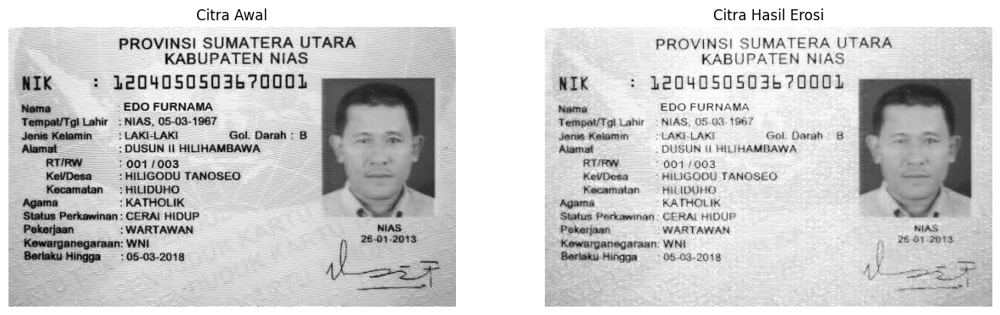

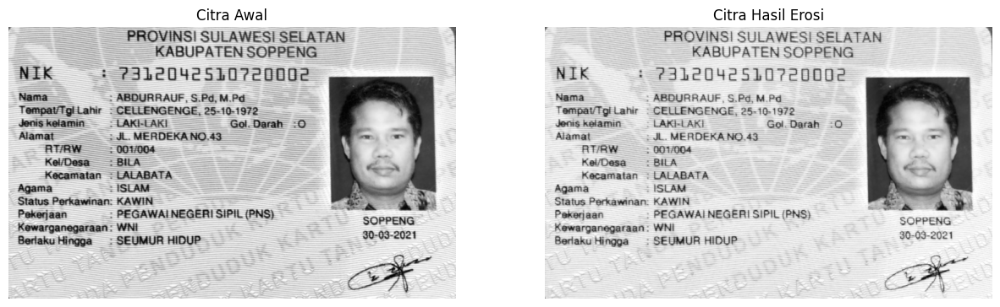

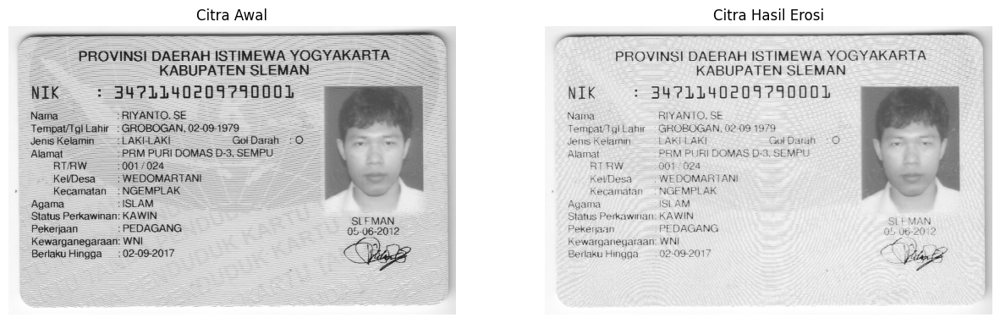

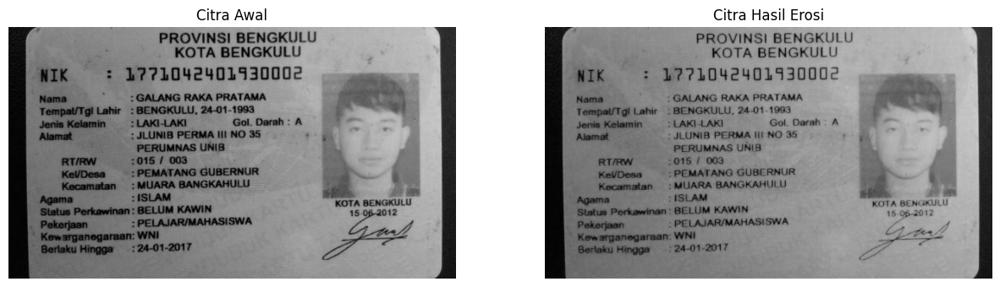

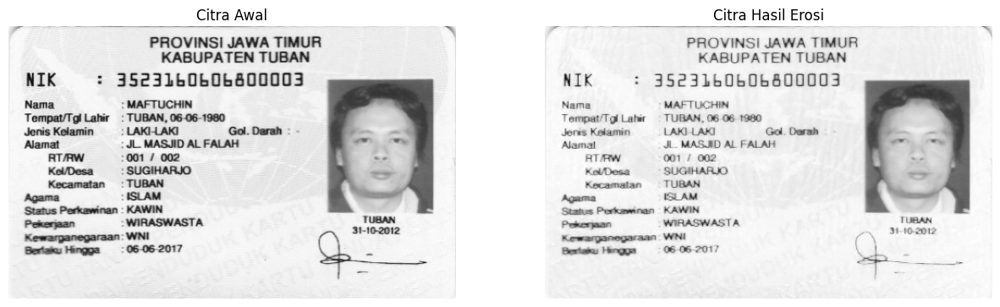

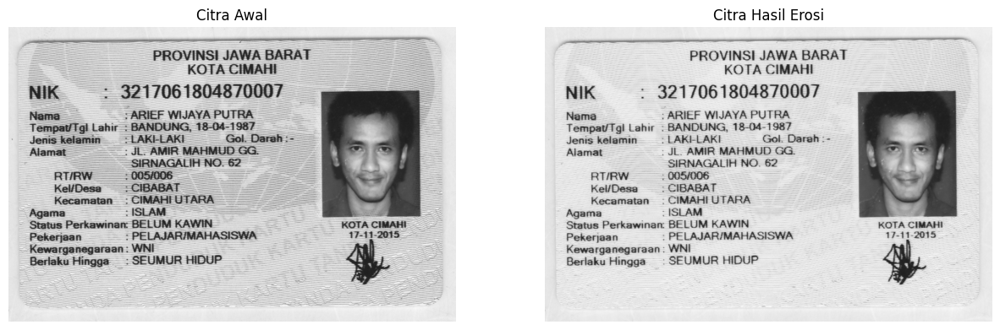

In [152]:
def inverse(image):
  return 255 - image

ktp_files = [file for file in os.listdir(path) if file.lower().endswith(('.png', '.jpg', '.jpeg'))]

for i, ktp_file in enumerate(ktp_files):
    ktp_path = os.path.join(path, ktp_file)

    ktp_image = cv2.imread(ktp_path, cv2.IMREAD_GRAYSCALE)

    inverse_image = inverse(ktp_image)

    kernel = np.ones((2,2), np.uint8)

    erosion = cv2.morphologyEx(inverse_image, cv2.MORPH_ERODE, kernel)
    erosion_rgb = cv2.cvtColor(erosion, cv2.COLOR_GRAY2RGB)

    plt.figure(figsize=(15,15))
    plt.subplot(121), plt.imshow(cv2.cvtColor(ktp_image, cv2.COLOR_GRAY2RGB)), plt.title('Citra Awal')
    plt.axis('off')
    plt.subplot(122), plt.imshow(inverse(erosion_rgb)), plt.title('Citra Hasil Erosi')
    plt.axis('off')

### **Opening**

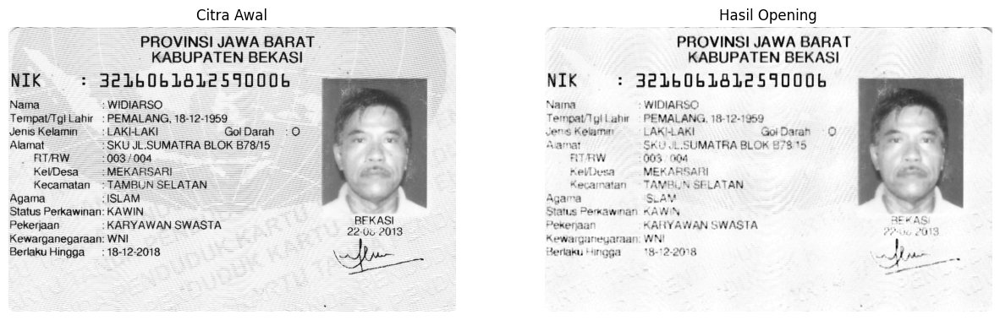

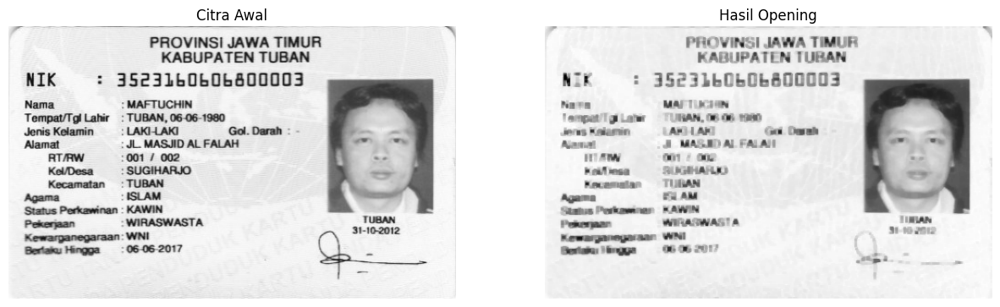

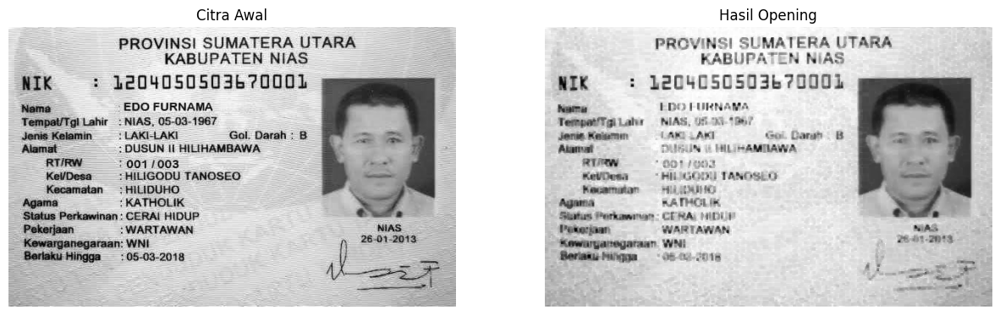

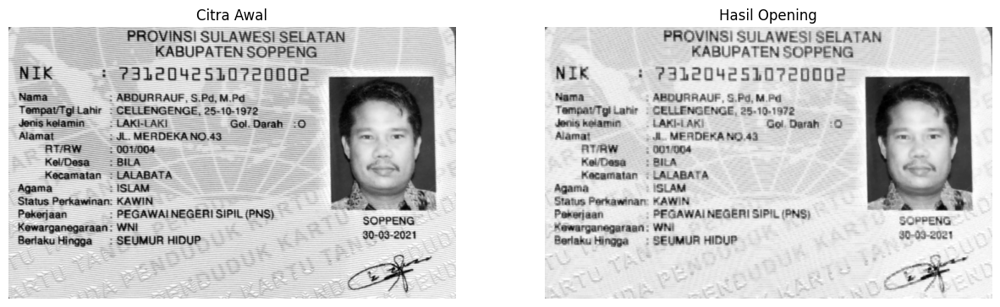

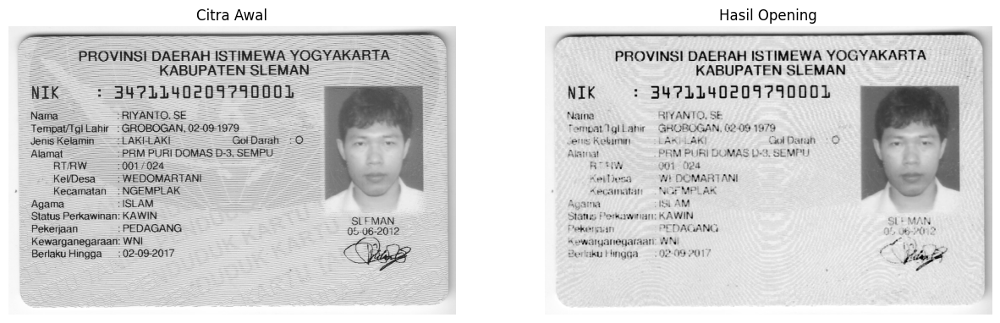

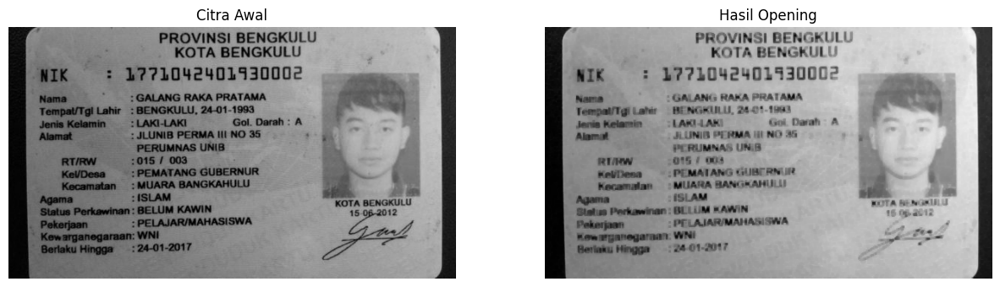

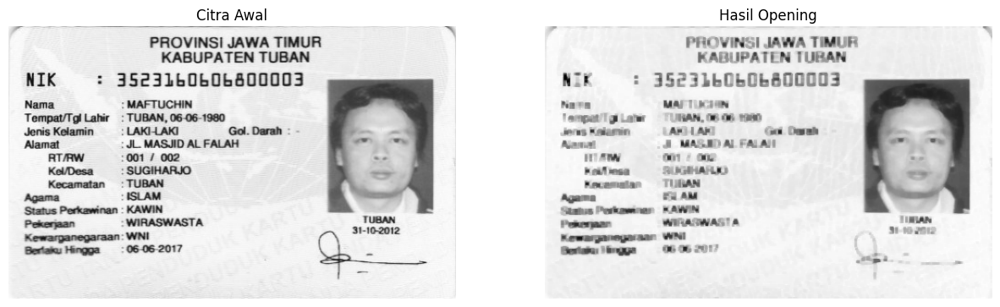

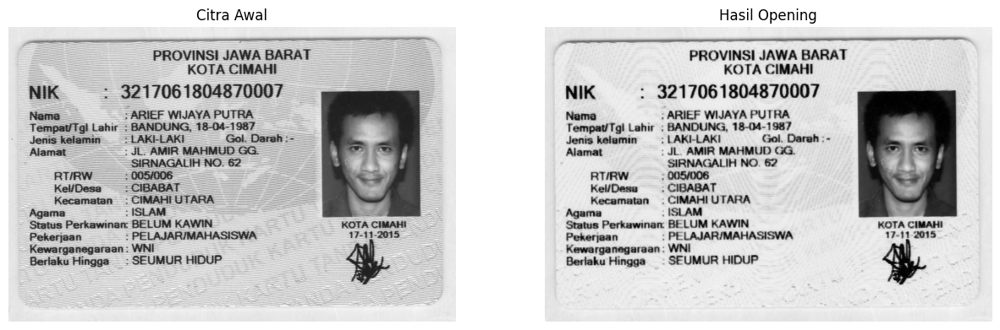

In [153]:
def inverse(image):
  return 255-image

# Baca citra
ktp_files = [file for file in os.listdir(path) if file.lower().endswith(('.png', '.jpg', '.jpeg'))]


for i, ktp_file in enumerate(ktp_files):
    ktp_path = os.path.join(path, ktp_file)

    ktp_image = cv2.imread(ktp_path, cv2.IMREAD_GRAYSCALE)

    inverse_img = inverse(ktp_image)

    se = np.ones((3, 3), dtype=np.uint8)

    # Lakukan erosi dengan SE 3x3
    eroded_image = cv2.erode(inverse_img, se, iterations=1)

    # Lakukan dilasi dengan SE 3x3 pada hasil erosi
    opening_image = cv2.dilate(eroded_image, se, iterations=1)

    ktp_rgb = cv2.cvtColor(ktp_image, cv2.COLOR_GRAY2RGB)

    plt.figure(figsize=(15,15))

    # Menampilkan citra awal dan hasil opening
    plt.subplot(121), plt.imshow(ktp_rgb), plt.title('Citra Awal')
    plt.axis('off')
    plt.subplot(122), plt.imshow(inverse(opening_image), cmap='gray'), plt.title('Hasil Opening')
    plt.axis('off')

plt.show()

### **Closing**

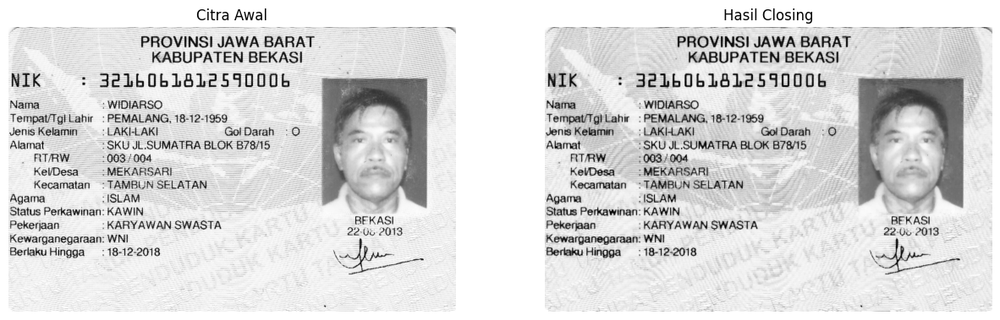

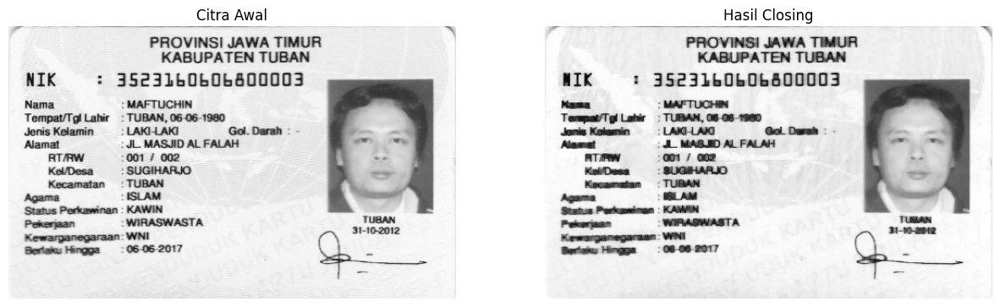

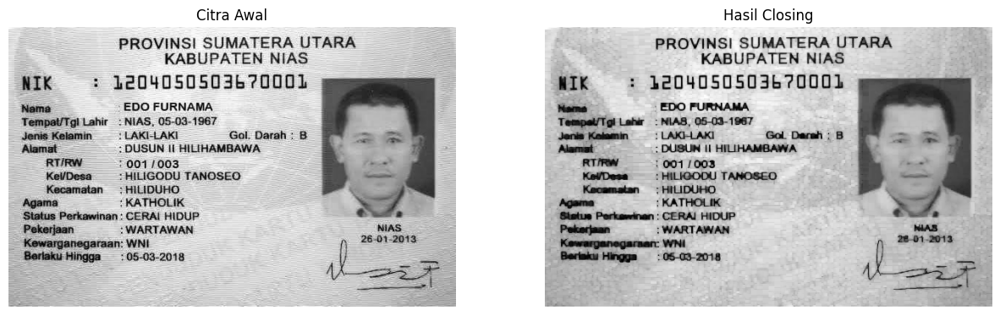

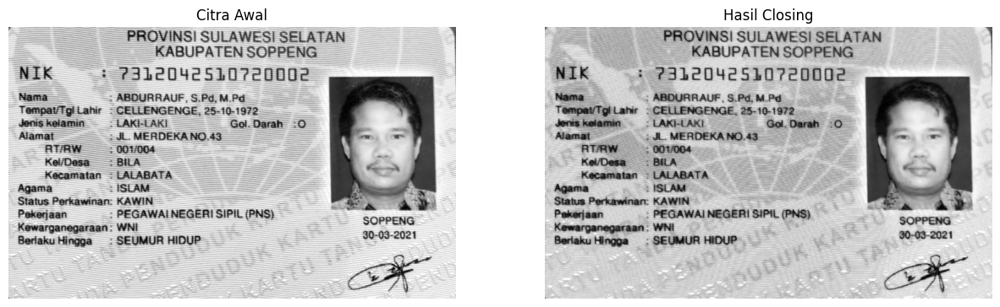

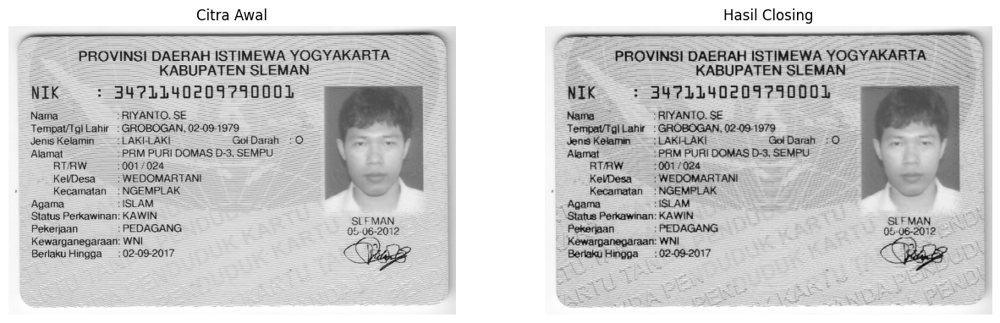

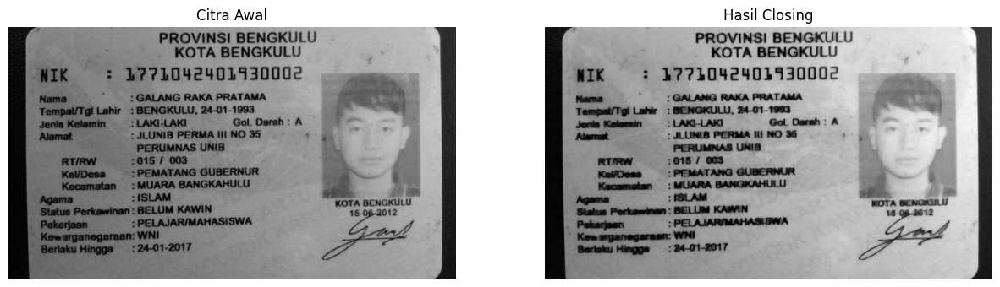

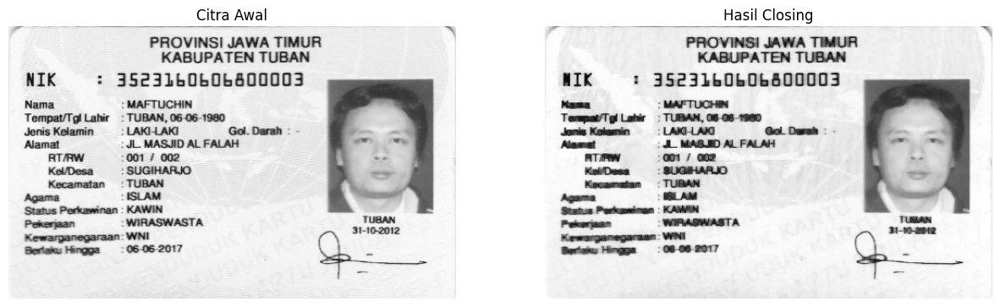

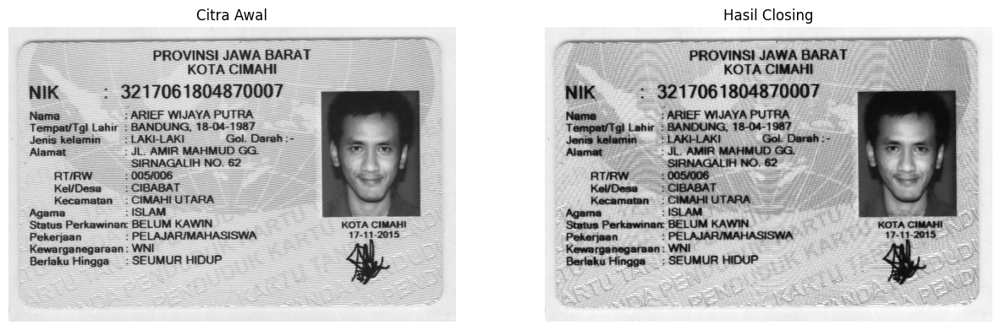

In [154]:
def inverse(image):
  return 255-image

# Baca citra
ktp_files = [file for file in os.listdir(path) if file.lower().endswith(('.png', '.jpg', '.jpeg'))]


for i, ktp_file in enumerate(ktp_files):
    ktp_path = os.path.join(path, ktp_file)

    ktp_image = cv2.imread(ktp_path, cv2.IMREAD_GRAYSCALE)

    inverse_img = inverse(ktp_image)

    se = np.ones((3, 3), dtype=np.uint8)

    # Lakukan erosi dengan SE 3x3
    dilated_image = cv2.dilate(inverse_img, se, iterations=1)

    # Lakukan dilasi dengan SE 3x3 pada hasil erosi
    closing_image = cv2.erode(dilated_image, se, iterations=1)

    ktp_rgb = cv2.cvtColor(ktp_image, cv2.COLOR_GRAY2RGB)

    plt.figure(figsize=(15,15))

    # Menampilkan citra awal dan hasil opening
    plt.subplot(121), plt.imshow(ktp_rgb), plt.title('Citra Awal')
    plt.axis('off')
    plt.subplot(122), plt.imshow(inverse(closing_image), cmap='gray'), plt.title('Hasil Closing')
    plt.axis('off')

plt.show()

### **Top Hat**

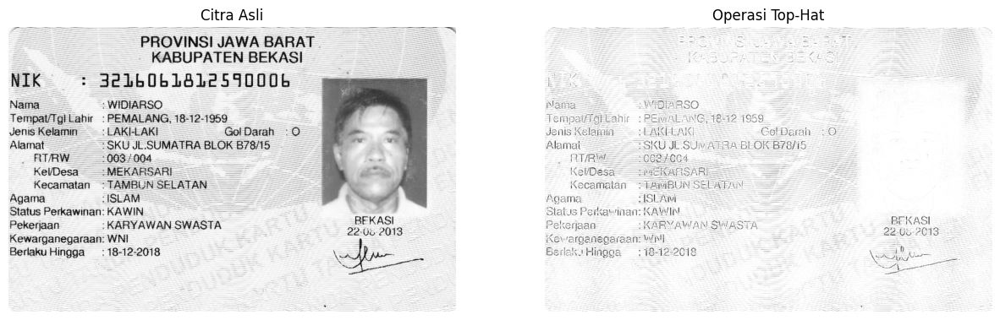

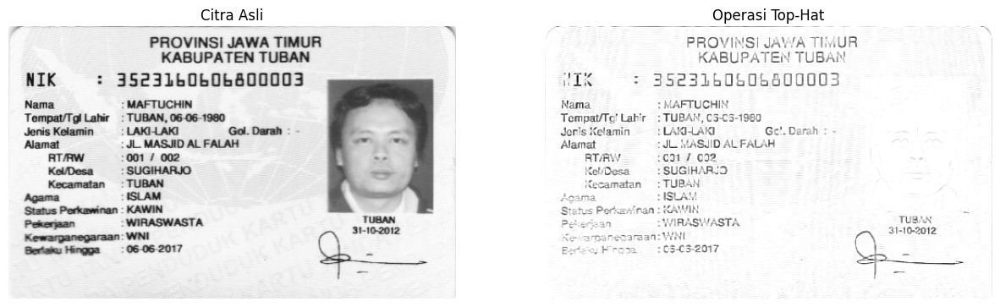

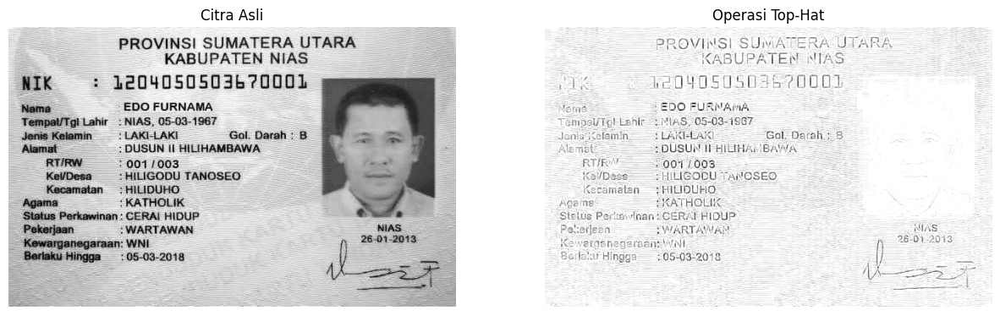

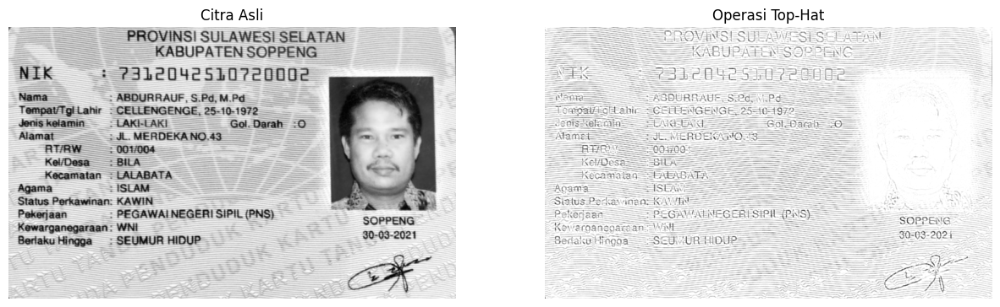

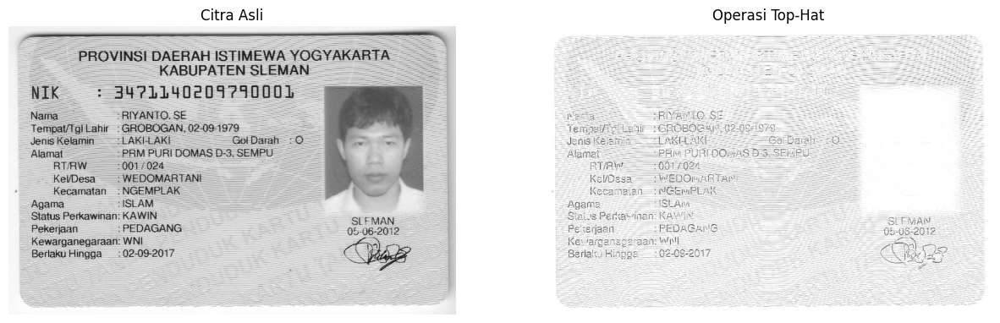

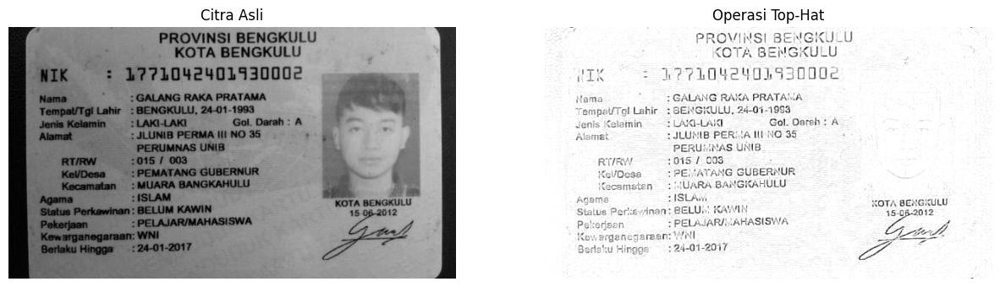

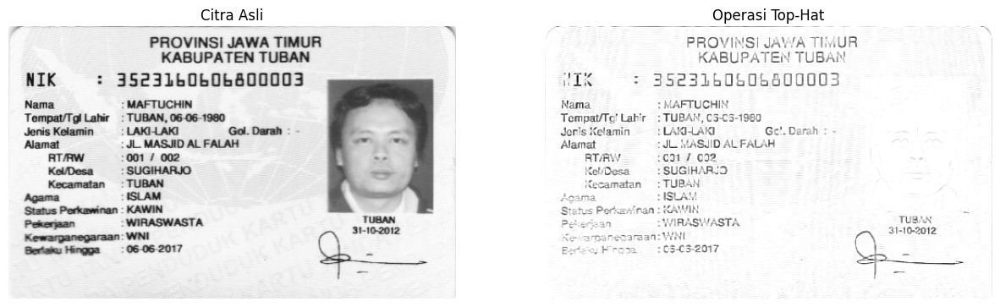

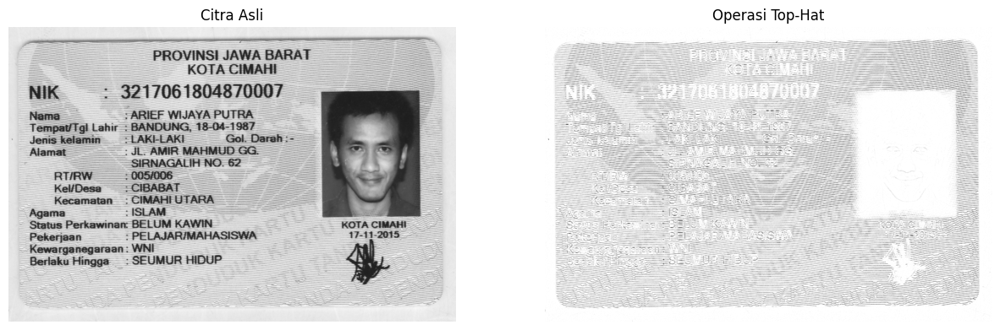

In [159]:
def inverse(image):
  return 255-image

# Baca citra
ktp_files = [file for file in os.listdir(folder_path) if file.lower().endswith(('.png', '.jpg', '.jpeg'))]


for i, ktp_file in enumerate(ktp_files):
    ktp_path = os.path.join(folder_path, ktp_file)

    ktp_image = cv2.imread(ktp_path, cv2.IMREAD_GRAYSCALE)

    inverse_img = inverse(ktp_image)

    se = np.ones((3, 3), dtype=np.uint8)

    # Lakukan operasi opening pada citra
    opened_image = cv2.morphologyEx(inverse_img, cv2.MORPH_OPEN, se)

    # Hitung operasi top-hat
    tophat_image = cv2.subtract(inverse_img, opened_image)

    plt.figure(figsize=(15,15))

    # Menampilkan citra asli dan hasil operasi top-hat
    plt.subplot(121), plt.imshow(cv2.cvtColor(ktp_image, cv2.COLOR_GRAY2RGB)), plt.title('Citra Asli')
    plt.axis('off')
    plt.subplot(122), plt.imshow(inverse(tophat_image), cmap='gray'), plt.title('Operasi Top-Hat')
    plt.axis('off')

plt.show()

### **Black Hat**

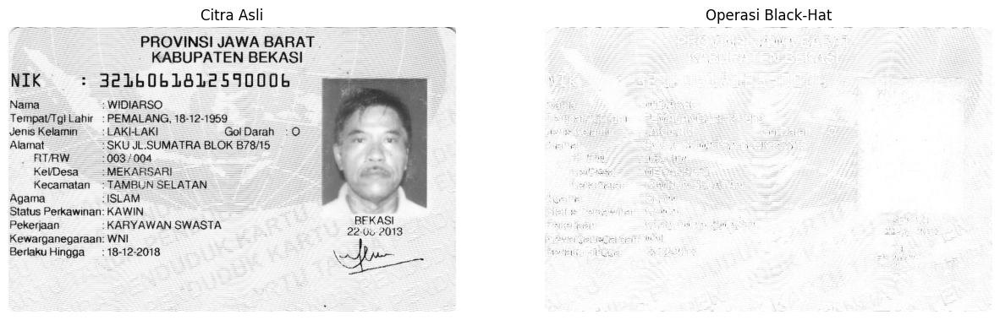

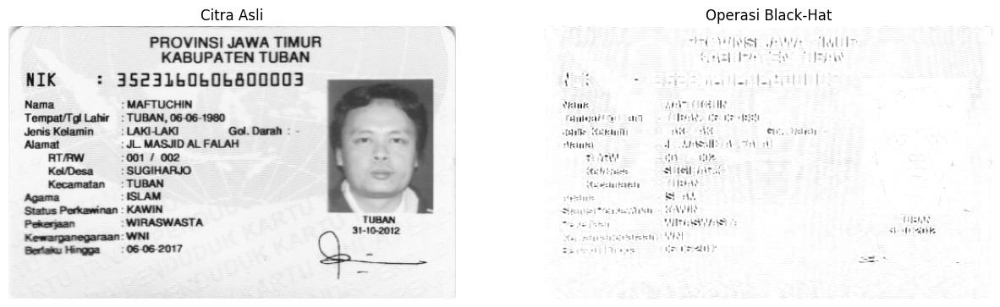

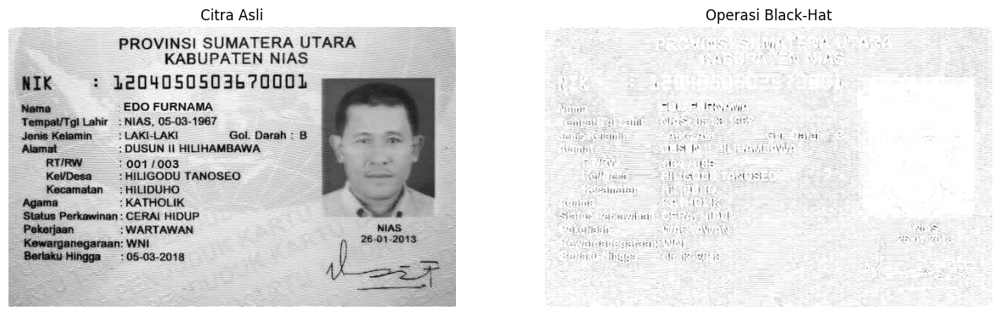

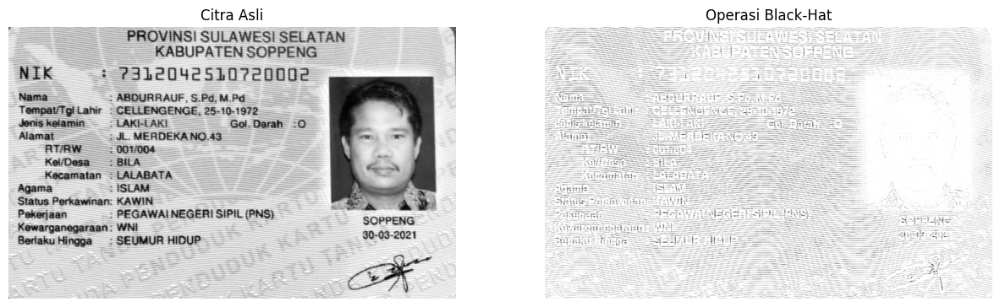

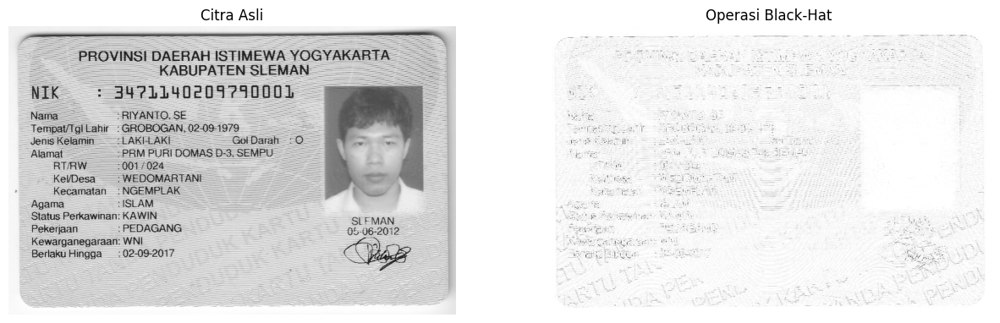

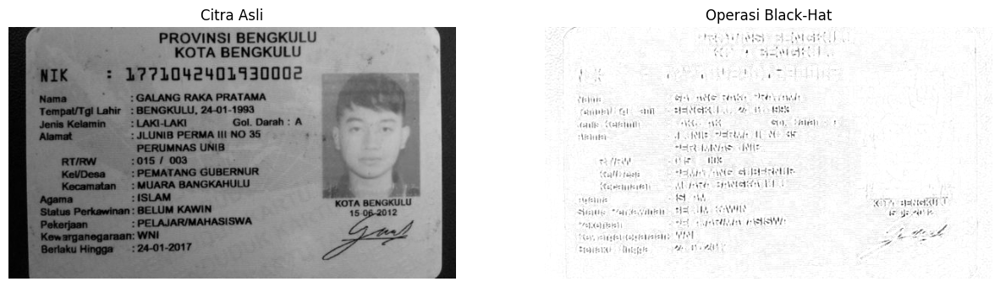

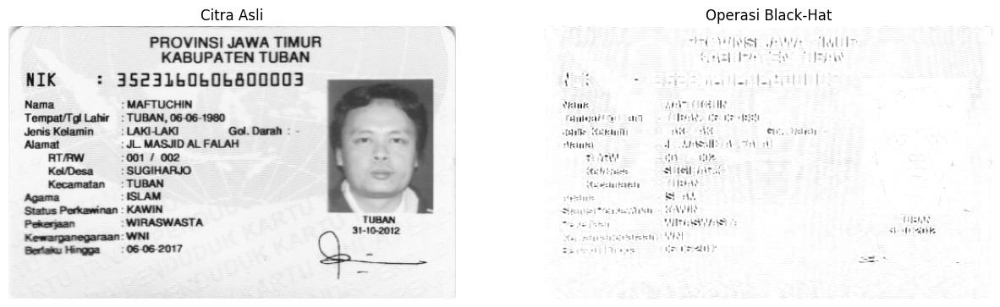

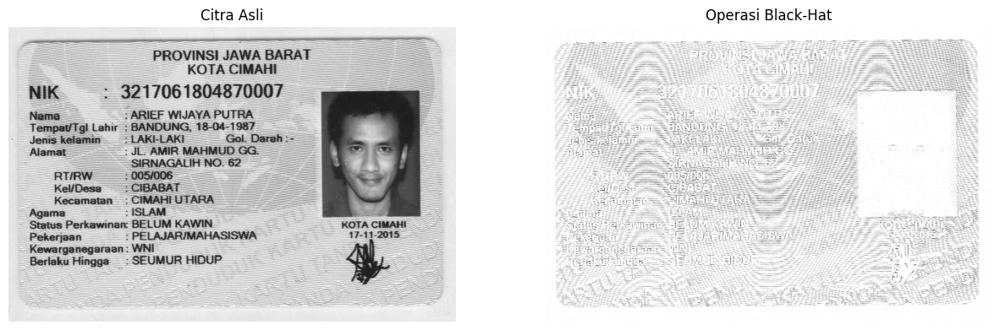

In [161]:
def inverse(image):
  return 255-image

# Baca citra
ktp_files = [file for file in os.listdir(path) if file.lower().endswith(('.png', '.jpg', '.jpeg'))]


for i, ktp_file in enumerate(ktp_files):
    ktp_path = os.path.join(path, ktp_file)

    ktp_image = cv2.imread(ktp_path, cv2.IMREAD_GRAYSCALE)

    inverse_img = inverse(ktp_image)

    se = np.ones((3, 3), dtype=np.uint8)

    # Lakukan operasi opening pada citra
    closed_image = cv2.morphologyEx(inverse_img, cv2.MORPH_CLOSE, se)

    # Hitung operasi top-hat
    blackhat_image = cv2.subtract(closed_image, inverse_img)

    plt.figure(figsize=(15,15))
    # Menampilkan citra asli dan hasil operasi top-hat
    plt.subplot(121), plt.imshow(cv2.cvtColor(ktp_image, cv2.COLOR_GRAY2RGB)), plt.title('Citra Asli')
    plt.axis('off')
    plt.subplot(122), plt.imshow(inverse(blackhat_image), cmap='gray'), plt.title('Operasi Black-Hat')
    plt.axis('off')

plt.show()